In [67]:
pip install matplotlib


Note: you may need to restart the kernel to use updated packages.


In [68]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
from IPython.display import display


In [69]:
df = pd.read_pickle('D:\Projects\AI Fitness Tracker\data_resampled.pkl')

In [70]:
df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:08:05.200,0.013500,0.977000,-0.071000,-1.8904,2.4392,0.9388,B,bench,heavy,30
2019-01-11 15:08:05.400,-0.001500,0.970500,-0.079500,-1.6826,-0.8904,2.1708,B,bench,heavy,30
2019-01-11 15:08:05.600,0.001333,0.971667,-0.064333,2.5608,-0.2560,-1.4146,B,bench,heavy,30
2019-01-11 15:08:05.800,-0.024000,0.957000,-0.073500,8.0610,-4.5244,-2.0730,B,bench,heavy,30
2019-01-11 15:08:06.000,-0.028000,0.957667,-0.115000,2.4390,-1.5486,-3.6098,B,bench,heavy,30
...,...,...,...,...,...,...,...,...,...,...
2019-01-20 17:33:27.000,-0.048000,-1.041500,-0.076500,1.4146,-5.6218,0.2926,E,row,medium,90
2019-01-20 17:33:27.200,-0.037000,-1.030333,-0.053333,-2.7684,-0.5854,2.2440,E,row,medium,90
2019-01-20 17:33:27.400,-0.060000,-1.031000,-0.082000,2.8416,-5.1342,-0.1220,E,row,medium,90


In [71]:
set_df = df[df['set']==1]

In [72]:
set_df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
epoch (ms),,,,,,,,,,
2019-01-11 15:10:08.400,0.003667,0.966333,-0.081000,1.8412,-4.7806,-2.5608,A,bench,heavy,1
2019-01-11 15:10:08.600,-0.012500,0.962500,-0.089000,2.1950,-2.1096,-2.8538,A,bench,heavy,1
2019-01-11 15:10:08.800,-0.028000,0.867000,-0.125000,9.5246,-2.8290,-11.1828,A,bench,heavy,1
2019-01-11 15:10:09.000,-0.062000,0.873000,-0.155000,16.5608,-4.4268,-13.0368,A,bench,heavy,1
2019-01-11 15:10:09.200,-0.096667,0.904333,-0.169000,7.6952,-11.8538,-3.0364,A,bench,heavy,1
...,...,...,...,...,...,...,...,...,...,...
2019-01-11 15:10:24.000,0.038667,0.967667,-0.100000,-0.2194,-4.9756,-3.8658,A,bench,heavy,1
2019-01-11 15:10:24.200,0.018500,0.972500,-0.083000,0.7924,-1.8536,0.6220,A,bench,heavy,1
2019-01-11 15:10:24.400,0.019667,0.970333,-0.079667,-1.9270,0.5852,-2.0246,A,bench,heavy,1


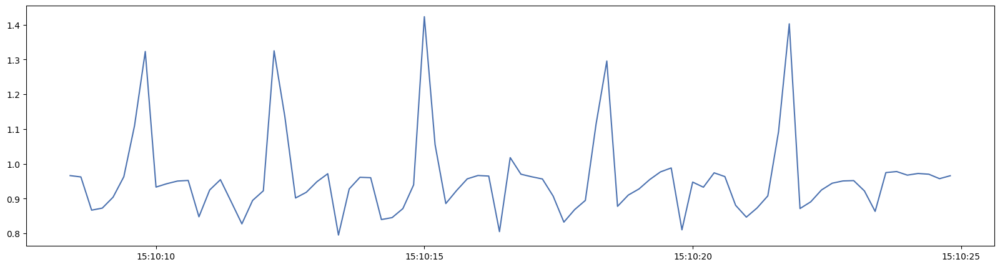

In [73]:
plt.plot(set_df['acc_y'], label='acc_y')

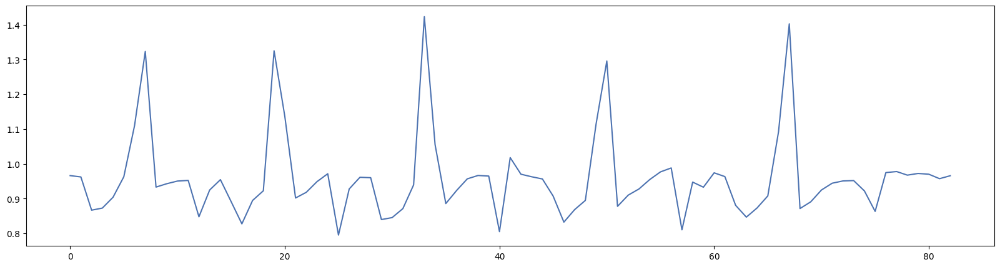

In [74]:
plt.plot(set_df['acc_y'].reset_index(drop=True), label='acc_y')

In [75]:
df['label'].unique()

array(['bench', 'ohp', 'squat', 'dead', 'row', 'rest'], dtype=object)

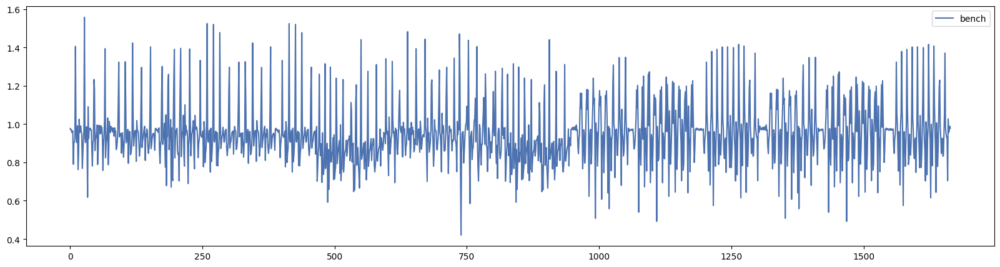

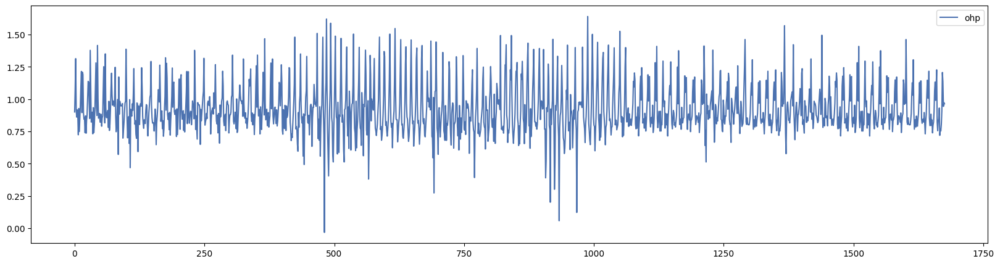

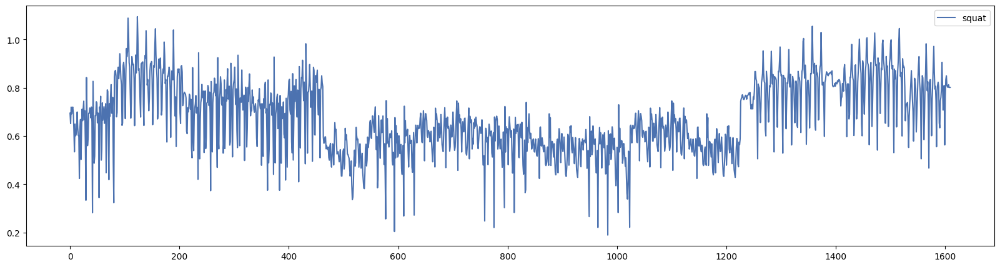

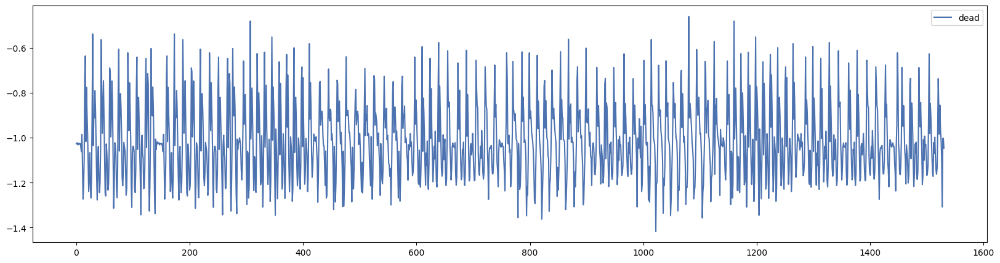

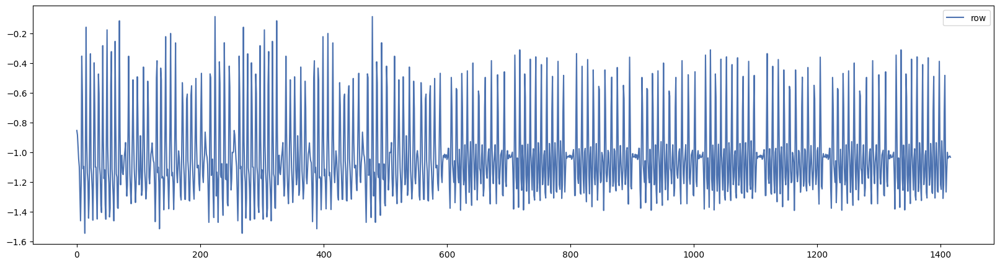

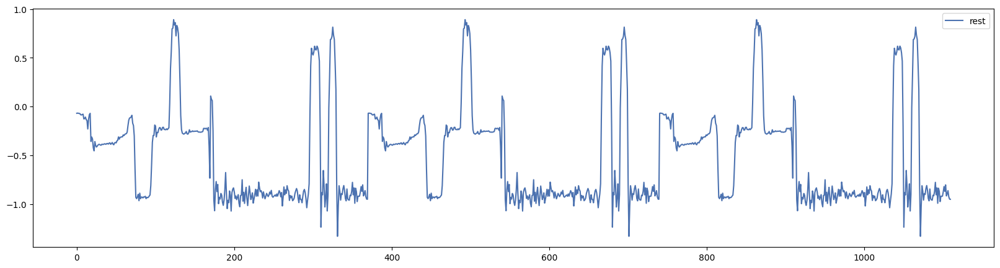

In [76]:
for i in df['label'].unique():
    sub_set = df[df['label']==i]
    fig, ax = plt.subplots()
    ax.plot(sub_set['acc_y'].reset_index(drop = True), label= i)
    plt.legend()
    plt.show()

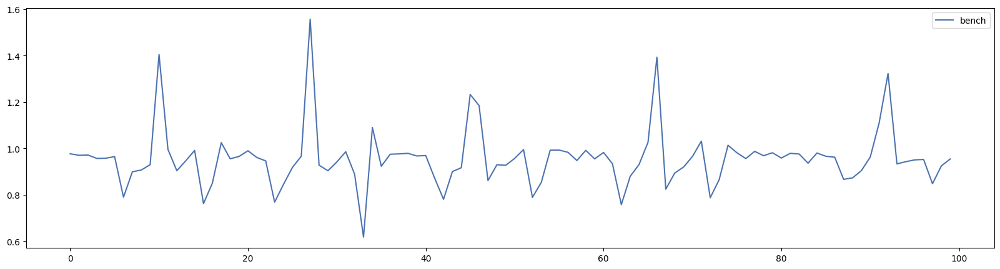

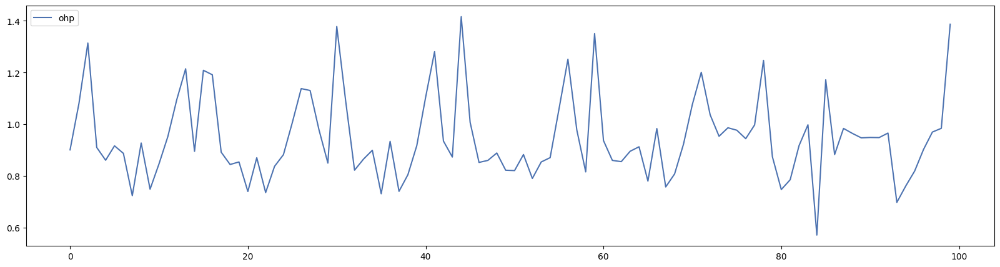

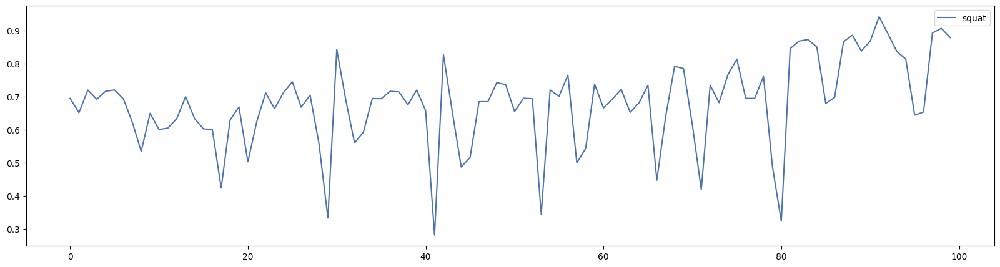

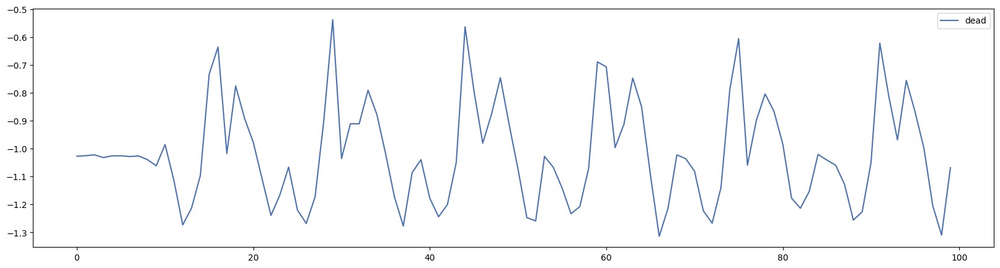

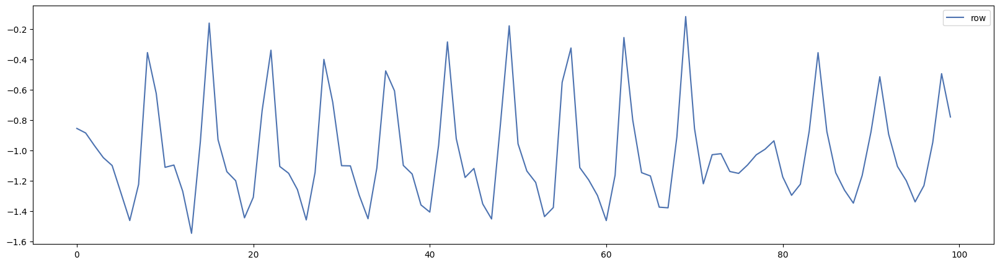

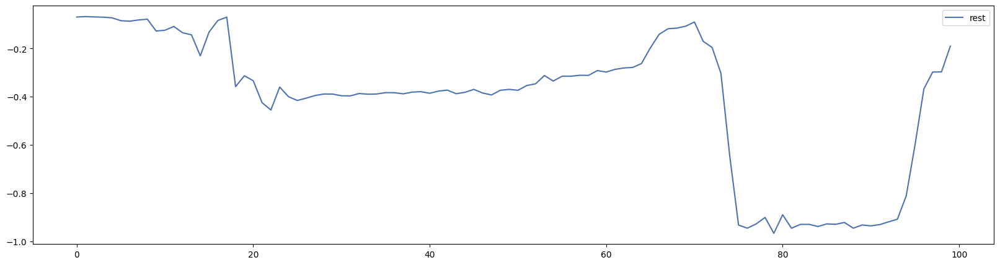

In [77]:
for i in df['label'].unique():
    sub_set = df[df['label']==i]
    fig, ax = plt.subplots()
    ax.plot(sub_set[:100]['acc_y'].reset_index(drop = True), label= i)
    plt.legend()
    plt.show()

In [78]:
mpl.style.use('seaborn-v0_8-deep')
mpl.rcParams['figure.figsize'] = (20,5)
mpl.rcParams["figure.dpi"] = 100

In [79]:
c_df =df.query('label == "squat"').query('participant == "A"').reset_index(drop=True)

In [80]:
c_df

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
0,0.135333,0.694667,0.735333,2.5366,-0.6220,1.6098,A,squat,medium,27
1,0.097500,0.651500,0.658000,2.0854,0.0366,0.1952,A,squat,medium,27
2,0.148667,0.719667,0.694333,-0.0364,1.2562,0.0242,A,squat,medium,27
3,0.138000,0.692000,0.632000,5.9878,-4.5734,1.0976,A,squat,medium,27
4,0.131667,0.716000,0.658000,-4.1586,-2.9636,-0.5852,A,squat,medium,27
...,...,...,...,...,...,...,...,...,...,...
619,0.022333,0.482667,0.656000,-8.0976,5.9026,2.9512,A,squat,heavy,26
620,0.028500,0.472500,0.657500,-5.4024,1.6340,3.1584,A,squat,heavy,26
621,0.012000,0.574667,0.839667,6.3904,-1.0854,2.0856,A,squat,heavy,26
622,0.010500,0.564000,0.785000,5.0246,-1.2196,1.8900,A,squat,heavy,26


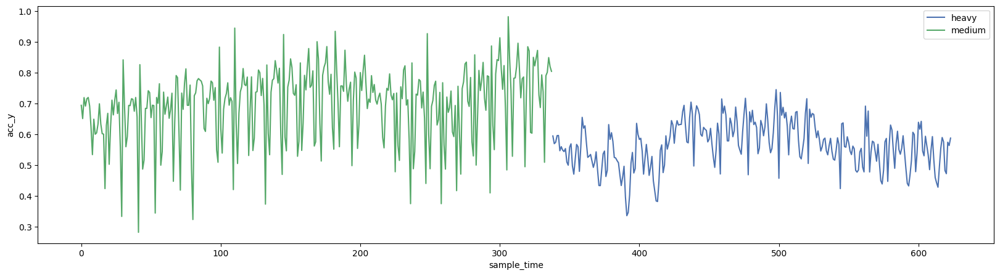

In [81]:
fig, ax = plt.subplots()
c_df.groupby('category')['acc_y'].plot(legend=True)
ax.set_ylabel('acc_y')
ax.set_xlabel ('sample_time')
plt.legend()
plt.show()

In [82]:
participant_df = df.query('label == "bench"')


In [83]:
participant_df_sorted = participant_df.sort_values(by='participant', ascending=True).reset_index(drop=True)

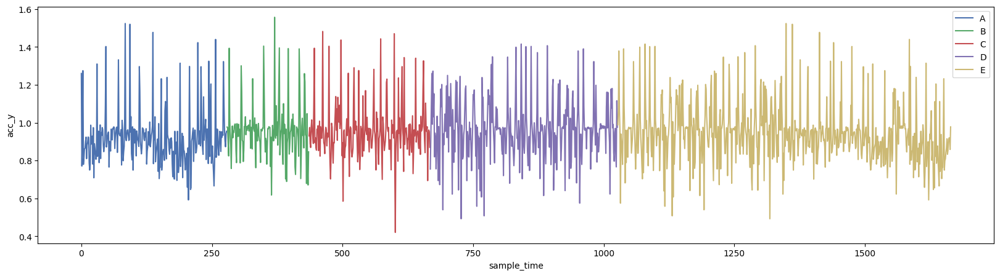

In [84]:
fig, ax = plt.subplots()
participant_df_sorted.groupby(['participant'])['acc_y'].plot(legend=True)
ax.set_ylabel('acc_y')
ax.set_xlabel ('sample_time')
plt.legend()
plt.show()

In [85]:
label = 'squat'
participant = 'A'
all_axis_data = df.query('label == @label').query('participant == @participant').reset_index(drop=True)

In [86]:
all_axis_data

,acc_x,acc_y,acc_z,gyr_x,gyr_y,gyr_z,participant,label,category,set
0,0.135333,0.694667,0.735333,2.5366,-0.6220,1.6098,A,squat,medium,27
1,0.097500,0.651500,0.658000,2.0854,0.0366,0.1952,A,squat,medium,27
2,0.148667,0.719667,0.694333,-0.0364,1.2562,0.0242,A,squat,medium,27
3,0.138000,0.692000,0.632000,5.9878,-4.5734,1.0976,A,squat,medium,27
4,0.131667,0.716000,0.658000,-4.1586,-2.9636,-0.5852,A,squat,medium,27
...,...,...,...,...,...,...,...,...,...,...
619,0.022333,0.482667,0.656000,-8.0976,5.9026,2.9512,A,squat,heavy,26
620,0.028500,0.472500,0.657500,-5.4024,1.6340,3.1584,A,squat,heavy,26
621,0.012000,0.574667,0.839667,6.3904,-1.0854,2.0856,A,squat,heavy,26
622,0.010500,0.564000,0.785000,5.0246,-1.2196,1.8900,A,squat,heavy,26


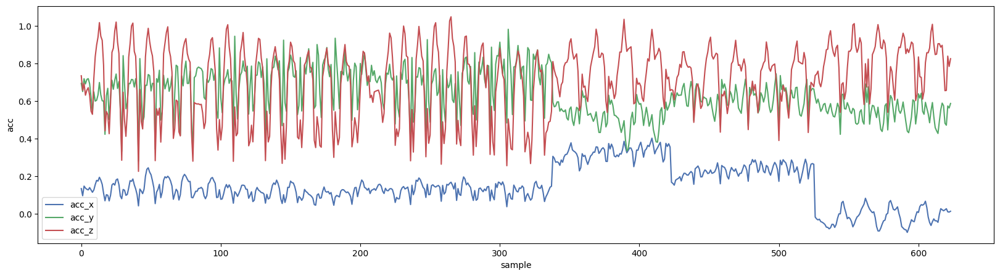

In [87]:
fig, ax = plt.subplots()
all_axis_data[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax, legend=True)
ax.set_ylabel('acc')
ax.set_xlabel ('sample')
plt.legend()
plt.show()


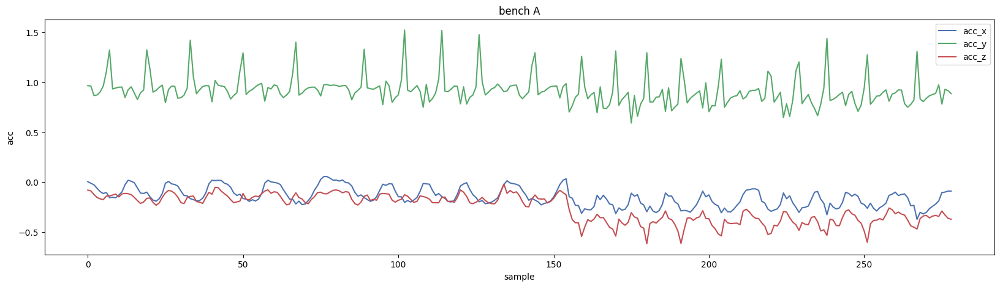

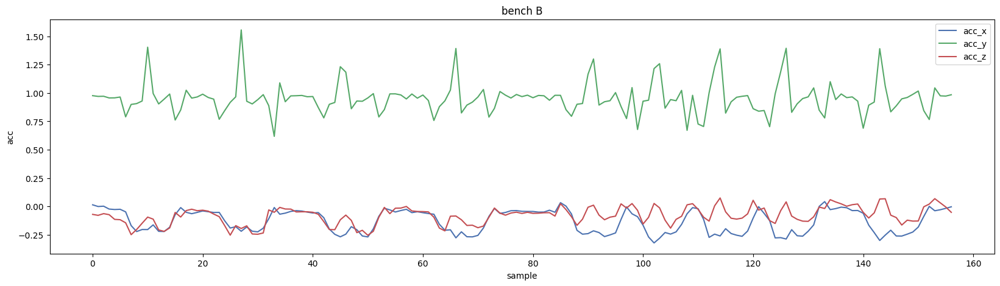

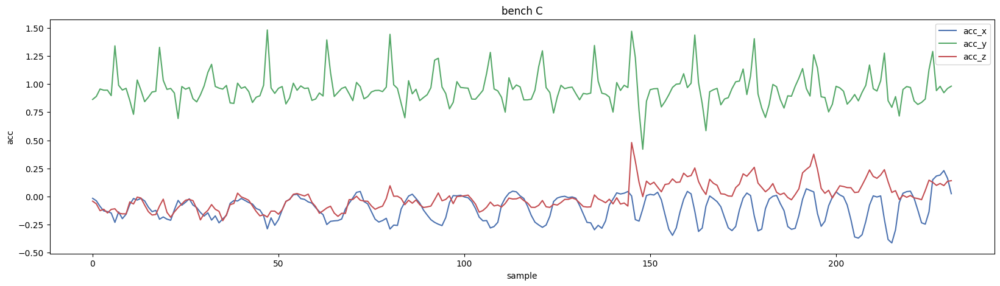

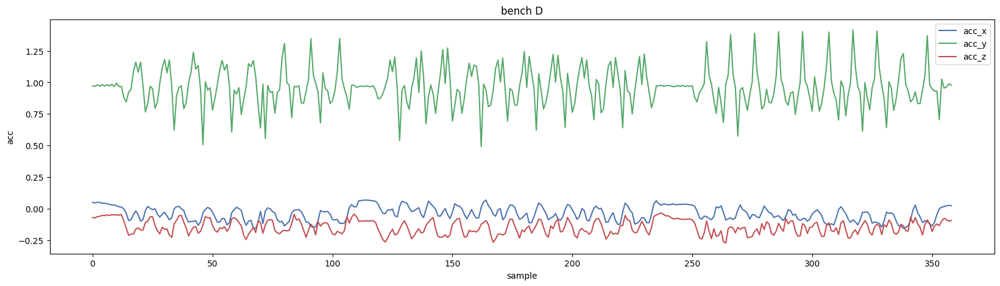

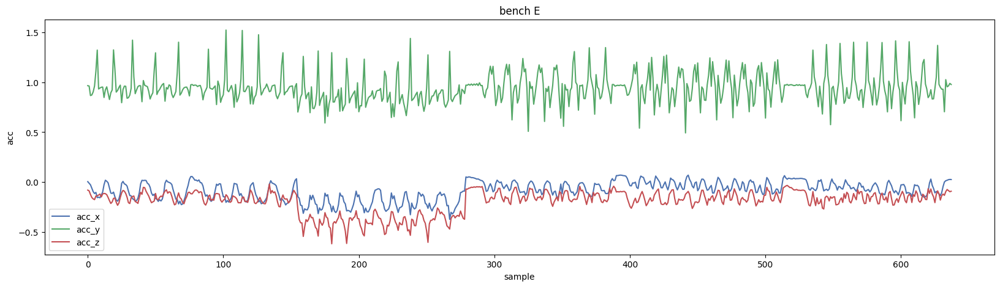

...

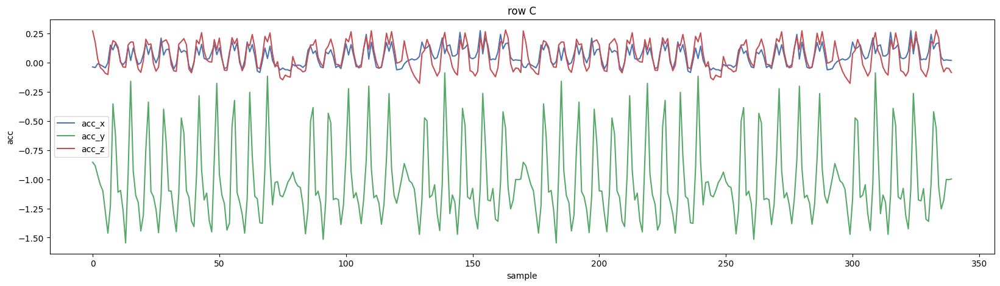

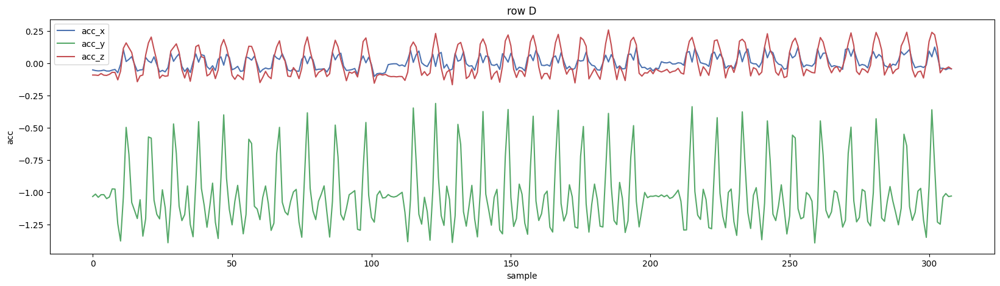

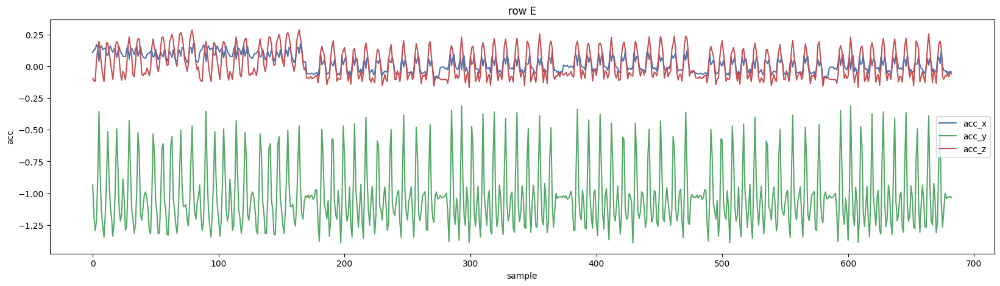

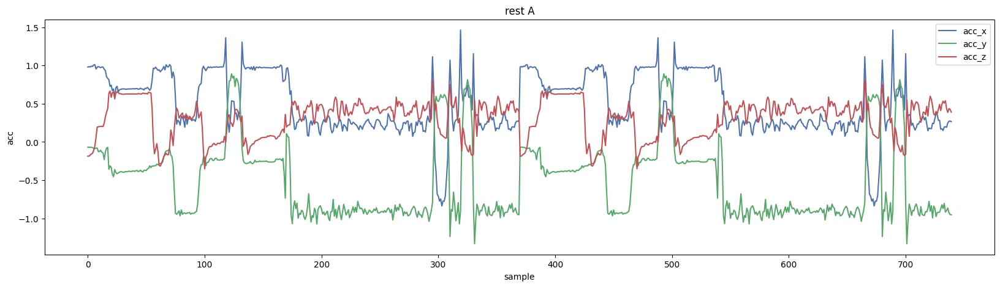

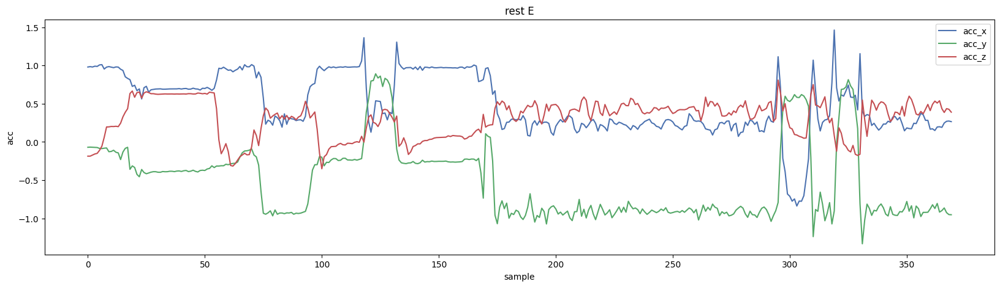

In [95]:
labels = df['label'].unique()
participants = np.sort(df['participant'].unique()) 
for label in labels:
    for participant in participants:
        all_axis_data = df.query('label == @label').query('participant == @participant').reset_index(drop=True)
        if len(all_axis_data) > 0:
            fig, ax = plt.subplots()
            all_axis_data[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax, legend=True)
            ax.set_ylabel('acc')
            ax.set_xlabel ('sample')
            ax.set_title(label + ' ' + participant)
            plt.legend()
            plt.show()

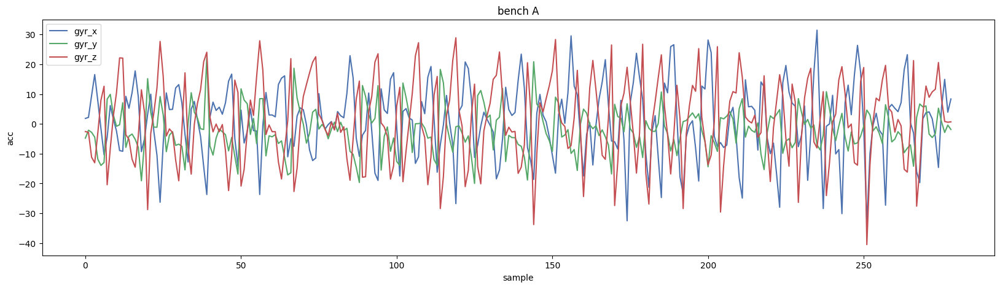

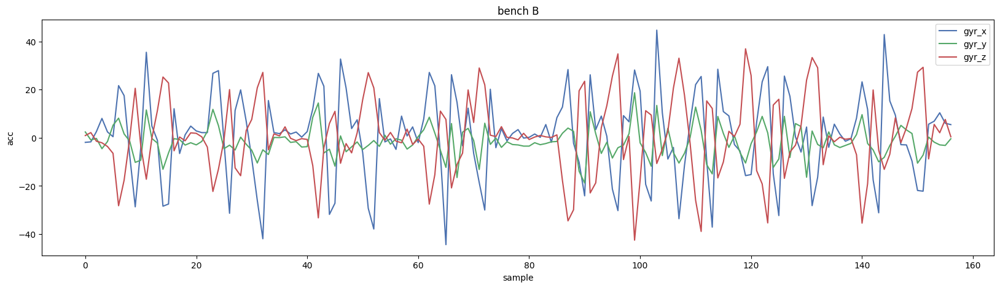

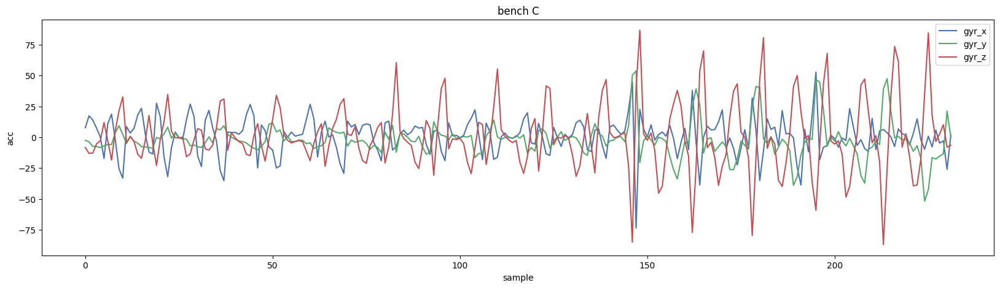

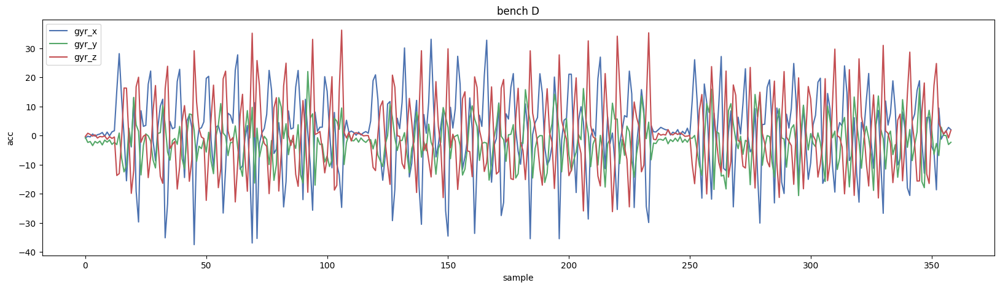

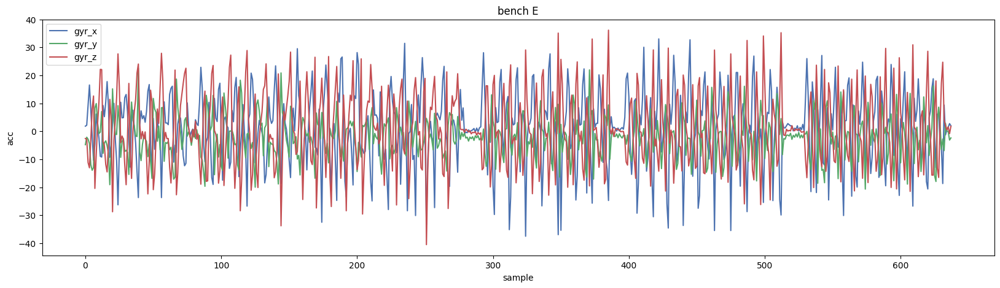

...

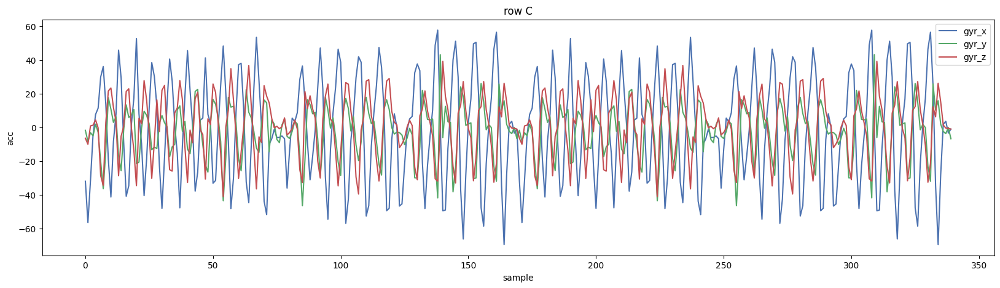

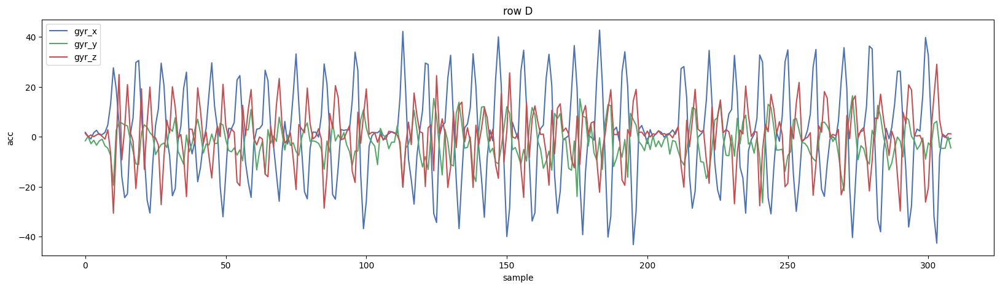

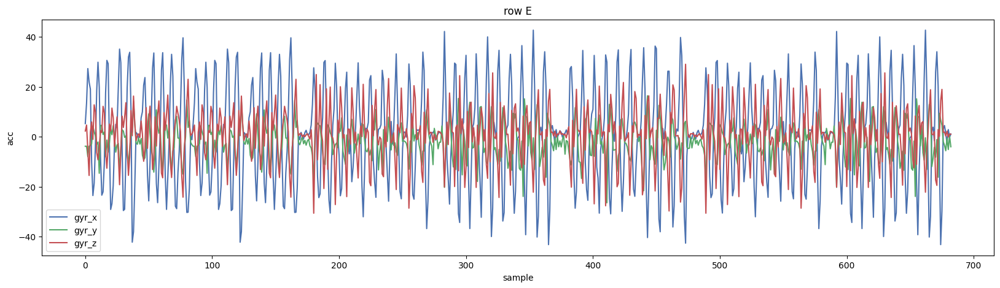

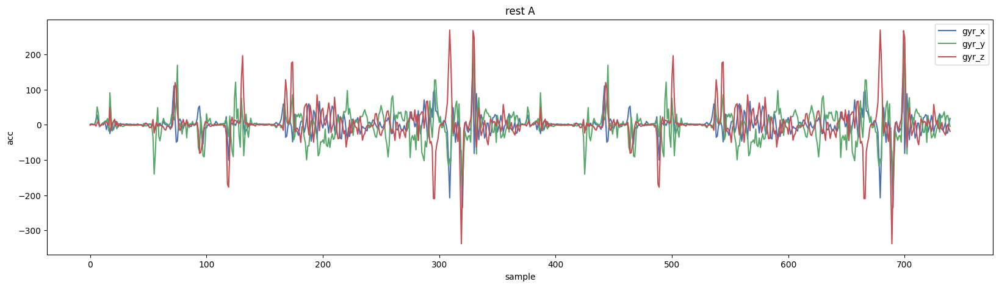

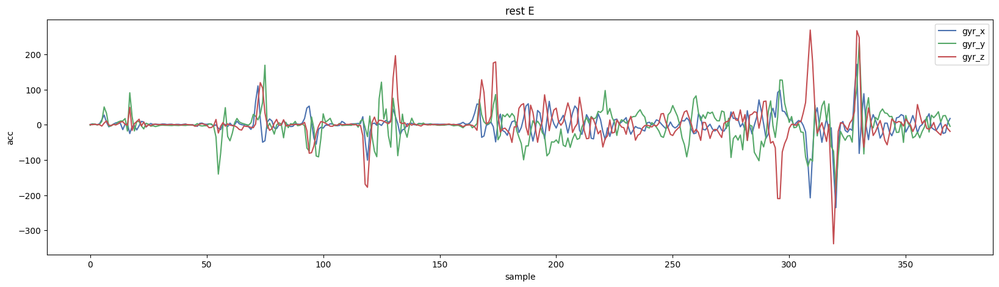

In [96]:
labels = df['label'].unique()
participants = np.sort(df['participant'].unique()) 
for label in labels:
    for participant in participants:
        all_axis_data = df.query('label == @label').query('participant == @participant').reset_index(drop=True)
        if len(all_axis_data) > 0:
            fig, ax = plt.subplots()
            all_axis_data[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax, legend=True)
            ax.set_ylabel('acc')
            ax.set_xlabel ('sample')
            ax.set_title(label + ' ' + participant)
            plt.legend()
            plt.show()

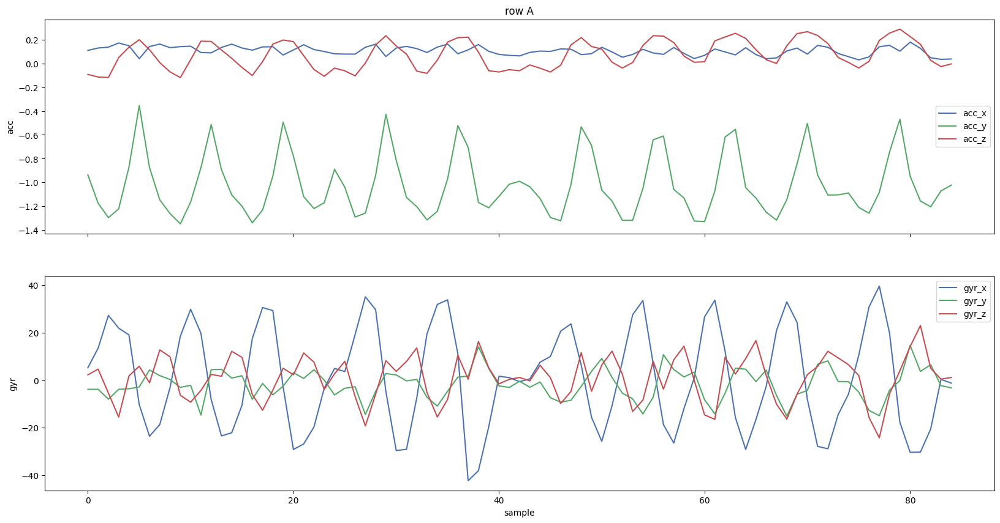

In [97]:
label = "row"
participant = "A"
all_axis_data = df.query('label == @label').query('participant == @participant').reset_index(drop=True)
fig, ax = plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(20,10))
all_axis_data[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax[0], legend=True)
all_axis_data[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax[1], legend=True)
ax[0].set_ylabel('acc')
ax[1].set_ylabel('gyr')
ax[1].set_xlabel ('sample')
ax[0].set_title(label + ' ' + participant)
plt.legend()
plt.show()

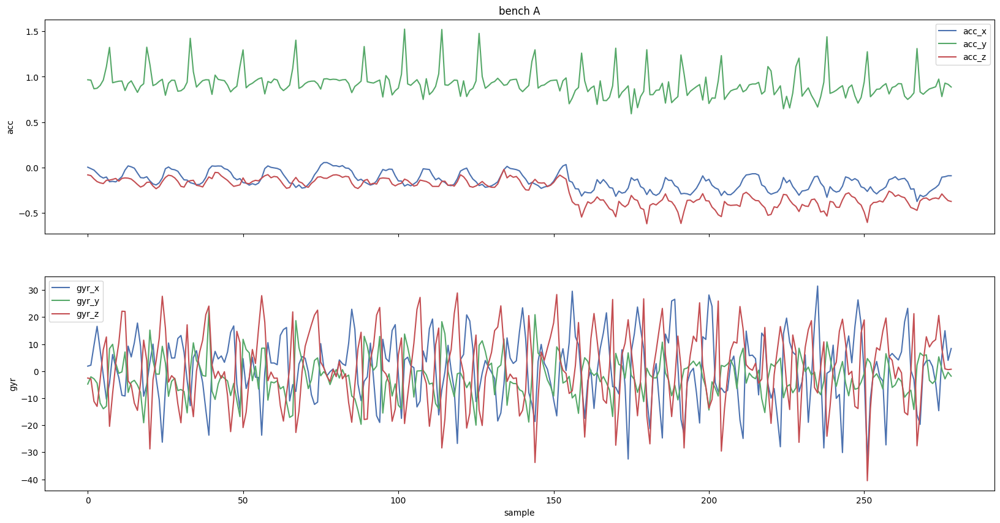

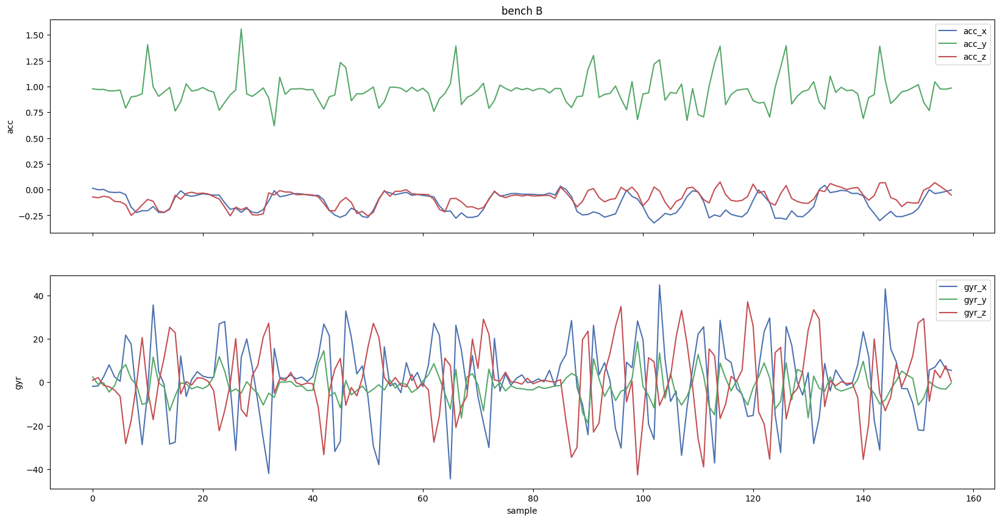

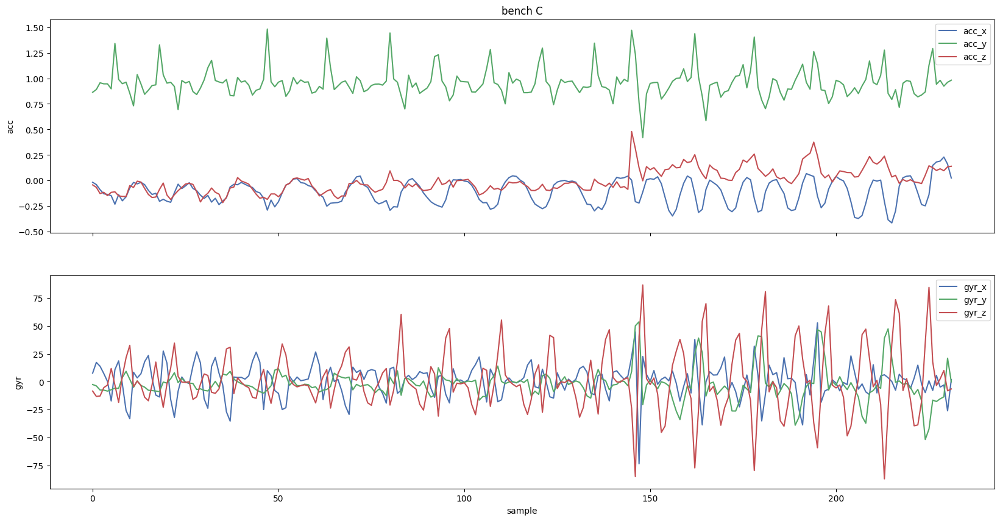

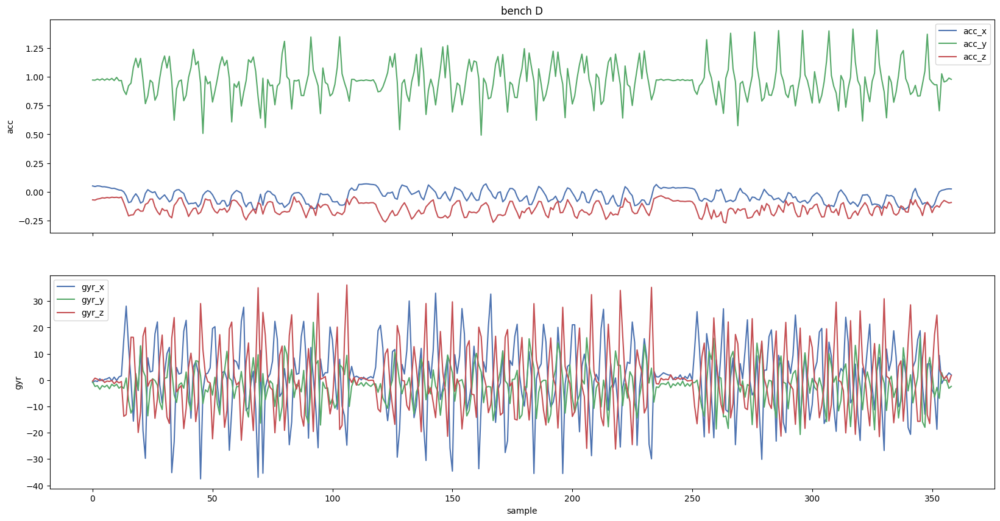

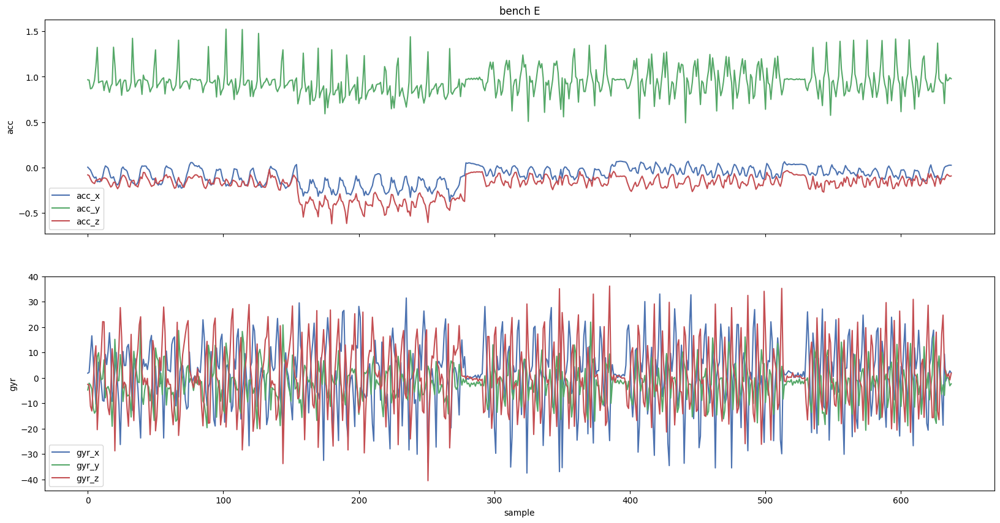

...

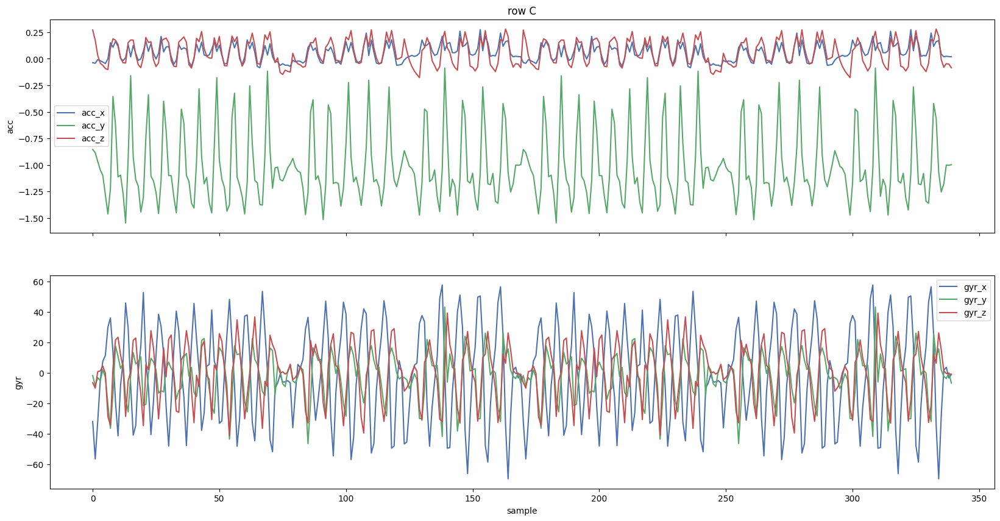

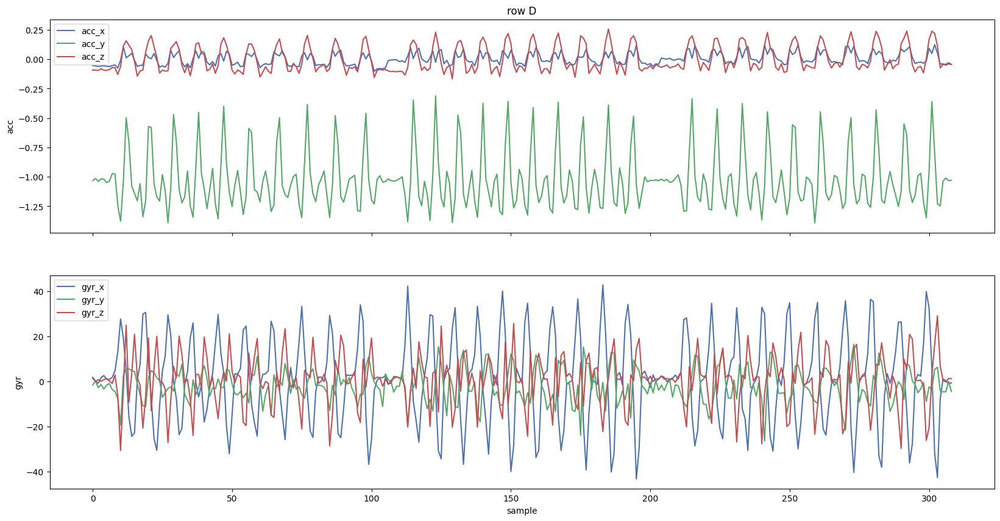

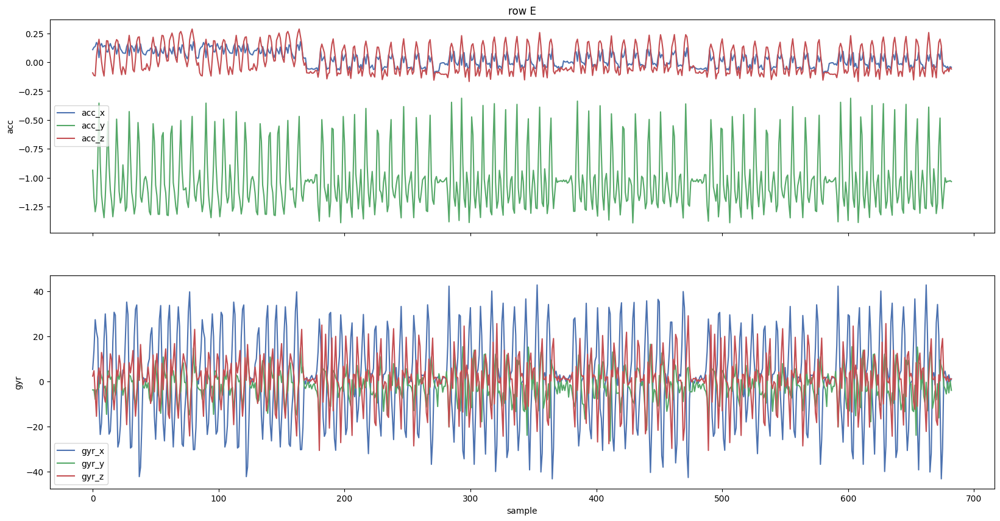

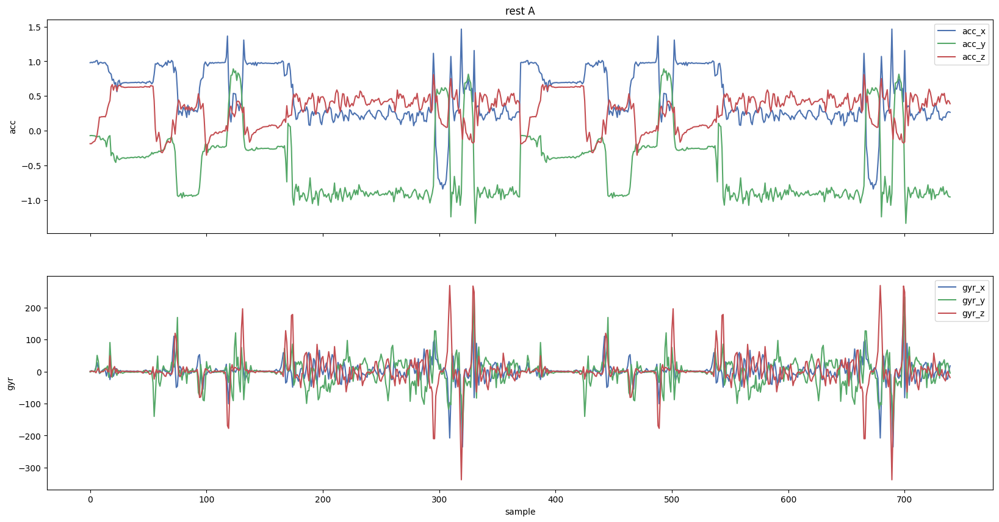

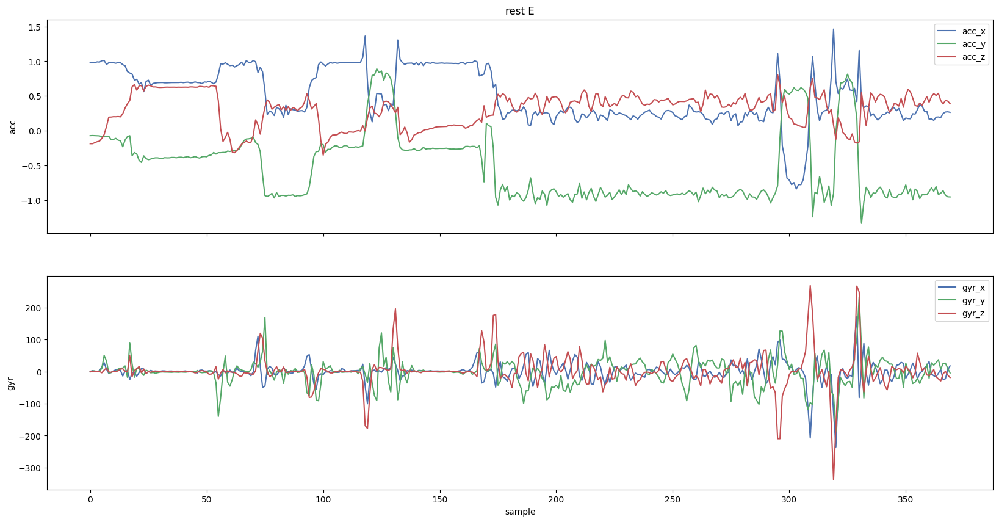

In [103]:
labels = df['label'].unique()
participants = np.sort(df['participant'].unique()) 
for label in labels:
    for participant in participants:
        combined_df = df.query('label == @label').query('participant == @participant').reset_index(drop=True)
        if len(combined_df) > 0:
            fig, ax = plt.subplots(nrows=2, ncols=1, sharex=True, figsize=(20,10))
            combined_df[['acc_x', 'acc_y', 'acc_z']].plot(ax=ax[0], legend=True)
            combined_df[['gyr_x', 'gyr_y', 'gyr_z']].plot(ax=ax[1], legend=True)
            ax[0].set_ylabel('acc')
            ax[1].set_ylabel ('gyr')
            ax[1].set_xlabel ('sample')
            ax[0].set_title(label + ' ' + participant)
            plt.legend()
            plt.savefig('D:\Projects\AI Fitness Tracker\MetaMotion\Plots\\' + label + '_' + participant + '.png')
            plt.show()